In [1]:
import os
from IPython.display import display
# Change working directory to ROOT
FILE = os.getcwd()

os.chdir(FILE +"/..")
os.getcwd()

'/home/ubuntu/microaneurism_detection'

In [7]:
from src.Fundus import Fundus
from src.plots import plot_color_bar
import numpy as np
from tqdm import tqdm
from PIL import Image
from sklearn.cluster import AgglomerativeClustering

In [8]:
%%time
# Load image
original = Fundus("data/ma/1.jpg")

CPU times: user 9.63 s, sys: 192 ms, total: 9.82 s
Wall time: 9.81 s


In [ ]:
# Get more frequent colors
#original.plot_color_bar(original.get_palette_sorted()[:10])

In [ ]:
#ma1 = Fundus(original.im.crop((3550,1850,3600,1900)))
#display(ma1.im)
#display(ma1.plot_color_bar(ma1.get_palette_sorted()[:10]))
#colors = ma1.palette[ma1.palette[:,1].argsort()][:100]
#Fundus(ma1.mask(colors, inplace=False, inverse=False), w=ma1.w, h=ma1.h).im

In [ ]:
#modified = Fundus(original.mask(colors, inplace=False, inverse=False), w=original.w, h=original.h)
#modified.im

In [ ]:
#ma2 = Fundus(original.im.crop((3740, 920, 3793, 974)))
#display(ma2.im)
#display(ma2.plot_color_bar(ma2.get_palette_sorted()[:10]))
#colors2 = ma2.palette[ma2.palette[:,1].argsort()][:100]
#display(Fundus(ma2.mask(colors2, inplace=False, inverse=False), w=ma2.w, h=ma2.h).im)

In [ ]:
#%%time
#modified = Fundus(original.mask(colors2, inplace=False, inverse=False),w=original.w,h=original.h)
#modified.im

100%|██████████| 30183/30183 [1:24:39<00:00,  5.94it/s]


CPU times: user 1h 12min 15s, sys: 15min 47s, total: 1h 28min 2s
Wall time: 1h 27min 47s


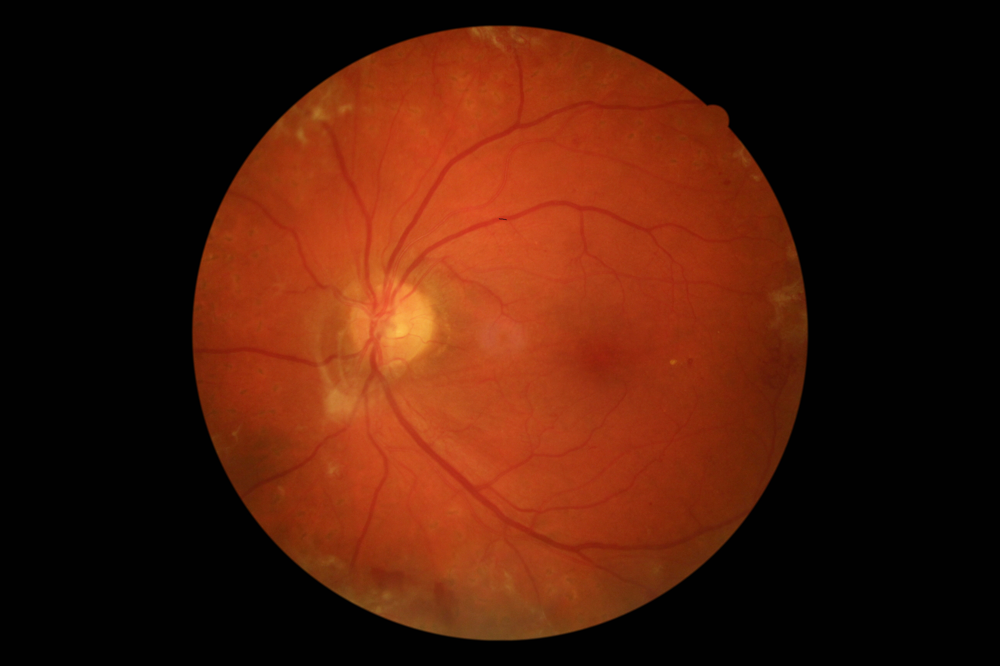

In [9]:
%%time
def cluster_pixels(fundus, n):
    pal = fundus.palette
    
    cluster = AgglomerativeClustering(n_clusters=n, affinity='euclidean', linkage='ward')
    clustered = cluster.fit_predict(pal)

    a = np.zeros(fundus.pixels.shape, dtype=np.uint8)
    for c in tqdm(np.unique(clustered)):
        a+=fundus.mask(pal[clustered == c], inverse=True, replacement=pal[clustered == c][0])
        
    return Fundus(a, w=fundus.w, h=fundus.h)

modified = cluster_pixels(original, len(original.palette)//2)
modified.im

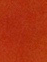

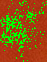

CPU times: user 48.6 ms, sys: 802 µs, total: 49.4 ms
Wall time: 45.5 ms


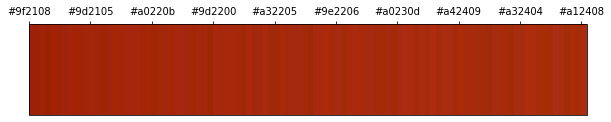

In [10]:
%%time
ma3 = Fundus(modified.im.crop((2970, 705, 3017, 767)))
display(ma3.im)
colors3 = sorted(ma3.palette, key=lambda x: x[1])[:100]
plot_color_bar(colors3)
display(Fundus(ma3.mask(colors3), w=ma3.w, h=ma3.h).im)

In [11]:
%%time
modified = original.mask(colors3)

CPU times: user 6.52 s, sys: 2.38 ms, total: 6.52 s
Wall time: 6.52 s


In [12]:
%%time
MOD = Fundus(modified, w=original.w, h=original.h)

CPU times: user 9.73 s, sys: 65.4 ms, total: 9.79 s
Wall time: 9.78 s


In [13]:
ma3.plot_palette()

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

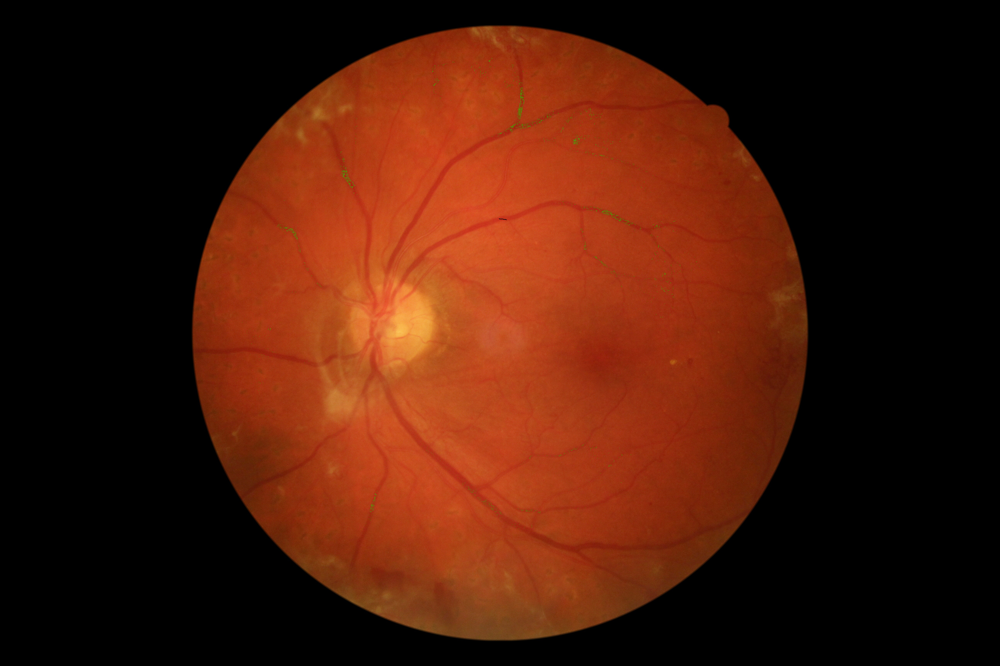

In [14]:
MOD.im